In [1]:
import torch
import torchvision
import nltk
import pycocotools
from tqdm import tqdm
from string import punctuation
from collections import Counter
import matplotlib.pyplot as plt
import torch.nn as nn
import os


In [2]:
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
device= torch.device('cuda' if torch.cuda.is_available() else 'cpu')


#### Beside importing the regular torch we have also imported punctuation encounter for text processing and we will be using macplot for displaying image numpy for array operation and equilibrium for visualising the progress bar

In [3]:
## using IMDB dataset for Sentiment analysis
# link: https://ai.stanford.edu/~amaas/data/sentiment/

In [4]:
!mkdir data_dir

!wget https://ai.stanford.edu/~amaas/data/sentiment/aclImdb_v1.tar.gz -P ./data_dir/
!tar -xvzf /content/data_dir/aclImdb_v1.tar.gz -C ./data_dir
!rm /content/data_dir/aclImdb_v1.tar.gz

Streaming output truncated to the last 5000 lines.
aclImdb/train/unsup/44983_0.txt
aclImdb/train/unsup/44982_0.txt
aclImdb/train/unsup/44981_0.txt
aclImdb/train/unsup/44980_0.txt
aclImdb/train/unsup/44979_0.txt
aclImdb/train/unsup/44978_0.txt
aclImdb/train/unsup/44977_0.txt
aclImdb/train/unsup/44976_0.txt
aclImdb/train/unsup/44975_0.txt
aclImdb/train/unsup/44974_0.txt
aclImdb/train/unsup/44973_0.txt
aclImdb/train/unsup/44972_0.txt
aclImdb/train/unsup/44971_0.txt
aclImdb/train/unsup/44970_0.txt
aclImdb/train/unsup/44969_0.txt
aclImdb/train/unsup/44968_0.txt
aclImdb/train/unsup/44967_0.txt
aclImdb/train/unsup/44966_0.txt
aclImdb/train/unsup/44965_0.txt
aclImdb/train/unsup/44964_0.txt
aclImdb/train/unsup/44963_0.txt
aclImdb/train/unsup/44962_0.txt
aclImdb/train/unsup/44961_0.txt
aclImdb/train/unsup/44960_0.txt
aclImdb/train/unsup/44959_0.txt
aclImdb/train/unsup/44958_0.txt
aclImdb/train/unsup/44957_0.txt
aclImdb/train/unsup/44956_0.txt
aclImdb/train/unsup/44955_0.txt
aclImdb/train/unsup/4

In [5]:
!ls /content/data_dir/aclImdb

imdbEr.txt  imdb.vocab	README	test  train


In [ ]:
# !rm /content/data_dir/aclImdb_v1.tar.gz

In [6]:
review_list=[]
label_list=[]
for label in ['pos','neg']:
  for fname in tqdm(os.listdir(f'/content/data_dir/aclImdb/train/{label}')):
    print("fname is :", fname)
    if 'txt' not in fname:
      continue
    with open(f'/content/data_dir/aclImdb/train/{label}/{fname}','r',encoding='utf-8') as f:
      review_list+=[f.read()]
      label_list+=[label]
print("Number of reviews are:" ,len(review_list))

 41%|████      | 5145/12500 [00:00<00:00, 25763.95it/s]

fname is : 2561_7.txt
fname is : 1161_8.txt
fname is : 5498_7.txt
fname is : 4236_8.txt
fname is : 9050_8.txt
fname is : 9315_7.txt
fname is : 10923_9.txt
fname is : 1819_9.txt
fname is : 436_10.txt
fname is : 10547_9.txt
fname is : 6218_7.txt
fname is : 6942_10.txt
fname is : 10603_10.txt
fname is : 10625_7.txt
fname is : 4496_8.txt
fname is : 9206_8.txt
fname is : 8624_7.txt
fname is : 9226_8.txt
fname is : 3857_9.txt
fname is : 8761_10.txt
fname is : 11411_8.txt
fname is : 2636_9.txt
fname is : 10702_10.txt
fname is : 7353_7.txt
fname is : 172_10.txt
fname is : 2243_7.txt
fname is : 1936_10.txt
fname is : 10015_8.txt
fname is : 2024_9.txt
fname is : 4344_9.txt
fname is : 10067_9.txt
fname is : 6385_10.txt
fname is : 4091_7.txt
fname is : 8407_7.txt
fname is : 2130_10.txt
fname is : 5384_8.txt
fname is : 8197_8.txt
fname is : 8461_7.txt
fname is : 7355_10.txt
fname is : 3046_10.txt
fname is : 11101_10.txt
fname is : 4580_8.txt
fname is : 1815_10.txt
fname is : 7102_7.txt
fname is : 4

 62%|██████▏   | 7722/12500 [00:00<00:00, 24540.61it/s]

fname is : 4176_10.txt
fname is : 5924_8.txt
fname is : 9130_9.txt
fname is : 7410_7.txt
fname is : 4585_10.txt
fname is : 6048_9.txt
fname is : 6511_10.txt
fname is : 10521_9.txt
fname is : 8926_10.txt
fname is : 1043_10.txt
fname is : 3184_8.txt
fname is : 8242_8.txt
fname is : 5652_10.txt
fname is : 706_10.txt
fname is : 1345_9.txt
fname is : 9769_8.txt
fname is : 10168_8.txt
fname is : 12387_10.txt
fname is : 11227_9.txt
fname is : 5110_10.txt
fname is : 6644_8.txt
fname is : 7236_8.txt
fname is : 3975_10.txt
fname is : 4439_8.txt
fname is : 9125_10.txt
fname is : 8648_9.txt
fname is : 9749_9.txt
fname is : 10375_10.txt
fname is : 12056_10.txt
fname is : 11987_7.txt
fname is : 5203_7.txt
fname is : 11380_7.txt
fname is : 3523_9.txt
fname is : 12336_9.txt
fname is : 8690_8.txt
fname is : 3574_10.txt
fname is : 2090_10.txt
fname is : 1636_10.txt
fname is : 11704_10.txt
fname is : 11681_9.txt
fname is : 9218_10.txt
fname is : 119_10.txt
fname is : 7421_7.txt
fname is : 1450_8.txt
fnam

100%|██████████| 12500/12500 [00:00<00:00, 22974.43it/s]


fname is : 7285_9.txt
fname is : 12041_9.txt
fname is : 2684_10.txt
fname is : 8090_9.txt
fname is : 8473_8.txt
fname is : 1195_8.txt
fname is : 7664_10.txt
fname is : 2063_8.txt
fname is : 9725_7.txt
fname is : 10494_10.txt
fname is : 3254_9.txt
fname is : 5933_7.txt
fname is : 6469_9.txt
fname is : 11220_10.txt
fname is : 3907_10.txt
fname is : 11141_10.txt
fname is : 7609_10.txt
fname is : 11388_8.txt
fname is : 9288_8.txt
fname is : 1054_8.txt
fname is : 5721_10.txt
fname is : 1014_9.txt
fname is : 1346_9.txt
fname is : 791_9.txt
fname is : 8663_7.txt
fname is : 8313_10.txt
fname is : 11492_7.txt
fname is : 5797_8.txt
fname is : 2896_9.txt
fname is : 4766_10.txt
fname is : 7999_10.txt
fname is : 879_8.txt
fname is : 1270_7.txt
fname is : 7840_8.txt
fname is : 10262_10.txt
fname is : 575_10.txt
fname is : 4258_9.txt
fname is : 7979_9.txt
fname is : 5049_9.txt
fname is : 12306_9.txt
fname is : 6139_10.txt
fname is : 6533_7.txt
fname is : 6999_7.txt
fname is : 2189_10.txt
fname is : 1

  0%|          | 0/12500 [00:00<?, ?it/s]

fname is : 6493_2.txt
fname is : 9437_2.txt
fname is : 9853_1.txt
fname is : 11827_3.txt
fname is : 1826_3.txt
fname is : 10269_1.txt
fname is : 5553_4.txt
fname is : 2538_4.txt
fname is : 4915_4.txt
fname is : 10097_1.txt
fname is : 1989_1.txt
fname is : 11660_1.txt
fname is : 6126_1.txt
fname is : 1105_2.txt
fname is : 399_2.txt
fname is : 441_2.txt
fname is : 3670_3.txt
fname is : 8635_4.txt
fname is : 4822_2.txt
fname is : 9229_2.txt
fname is : 9550_1.txt
fname is : 8765_4.txt
fname is : 8199_2.txt
fname is : 1871_4.txt
fname is : 10247_2.txt
fname is : 1995_1.txt
fname is : 790_1.txt
fname is : 9751_3.txt
fname is : 10376_1.txt
fname is : 8467_1.txt
fname is : 6602_2.txt
fname is : 4797_4.txt
fname is : 7909_2.txt
fname is : 6017_2.txt
fname is : 1254_4.txt
fname is : 8984_3.txt
fname is : 5034_4.txt
fname is : 5794_2.txt
fname is : 4550_3.txt
fname is : 5305_4.txt
fname is : 10739_4.txt
fname is : 9679_2.txt
fname is : 7605_4.txt
fname is : 1157_4.txt
fname is : 3662_4.txt
fname 

 19%|█▉        | 2370/12500 [00:00<00:00, 23693.13it/s]

fname is : 8868_1.txt
fname is : 9937_3.txt
fname is : 1152_3.txt
fname is : 11105_1.txt
fname is : 8773_1.txt
fname is : 1634_4.txt
fname is : 5898_4.txt
fname is : 12083_3.txt
fname is : 10079_1.txt
fname is : 6149_1.txt
fname is : 10374_1.txt
fname is : 1791_2.txt
fname is : 9087_1.txt
fname is : 7519_2.txt
fname is : 11084_4.txt
fname is : 926_1.txt
fname is : 6613_4.txt
fname is : 5977_1.txt
fname is : 9710_2.txt
fname is : 9581_2.txt
fname is : 12226_1.txt
fname is : 1876_4.txt
fname is : 3448_1.txt
fname is : 4889_3.txt
fname is : 4264_1.txt
fname is : 8530_1.txt
fname is : 3673_3.txt
fname is : 4438_1.txt
fname is : 2016_2.txt
fname is : 3201_2.txt
fname is : 4392_3.txt
fname is : 750_1.txt
fname is : 9497_3.txt
fname is : 6567_2.txt
fname is : 9650_1.txt
fname is : 6711_2.txt
fname is : 4525_1.txt
fname is : 6265_1.txt
fname is : 4972_3.txt
fname is : 6415_3.txt
fname is : 4830_2.txt
fname is : 6650_3.txt
fname is : 2914_3.txt
fname is : 6773_3.txt
fname is : 10742_1.txt
fname

 38%|███▊      | 4740/12500 [00:00<00:00, 23030.38it/s]

fname is : 2749_1.txt
fname is : 12363_1.txt
fname is : 5499_1.txt
fname is : 193_1.txt
fname is : 4729_3.txt
fname is : 8770_2.txt
fname is : 1233_1.txt
fname is : 5160_1.txt
fname is : 7430_4.txt
fname is : 11719_1.txt
fname is : 1204_4.txt
fname is : 470_3.txt
fname is : 7064_2.txt
fname is : 880_4.txt
fname is : 416_4.txt
fname is : 1049_3.txt
fname is : 2533_4.txt
fname is : 2285_1.txt
fname is : 11070_1.txt
fname is : 2975_4.txt
fname is : 89_2.txt
fname is : 10978_1.txt
fname is : 1099_4.txt
fname is : 5207_3.txt
fname is : 288_1.txt
fname is : 729_2.txt
fname is : 8929_2.txt
fname is : 1959_4.txt
fname is : 11402_4.txt
fname is : 10721_3.txt
fname is : 10291_4.txt
fname is : 3333_4.txt
fname is : 5343_1.txt
fname is : 9981_1.txt
fname is : 11414_1.txt
fname is : 372_1.txt
fname is : 3847_4.txt
fname is : 6234_1.txt
fname is : 7904_3.txt
fname is : 7607_4.txt
fname is : 3360_1.txt
fname is : 7682_2.txt
fname is : 12481_1.txt
fname is : 1582_1.txt
fname is : 2642_1.txt
fname is :

 56%|█████▋    | 7045/12500 [00:00<00:00, 20217.00it/s]

fname is : 10150_3.txt
fname is : 9584_4.txt
fname is : 11424_1.txt
fname is : 3321_4.txt
fname is : 8069_1.txt
fname is : 8232_1.txt
fname is : 12346_1.txt
fname is : 11562_2.txt
fname is : 614_2.txt
fname is : 10843_1.txt
fname is : 3710_1.txt
fname is : 8714_1.txt
fname is : 137_4.txt
fname is : 8034_1.txt
fname is : 11969_4.txt
fname is : 4193_3.txt
fname is : 1431_3.txt
fname is : 1160_1.txt
fname is : 12152_2.txt
fname is : 3715_2.txt
fname is : 6551_1.txt
fname is : 5049_3.txt
fname is : 44_2.txt
fname is : 11075_2.txt
fname is : 6063_4.txt
fname is : 11721_1.txt
fname is : 3990_2.txt
fname is : 10795_1.txt
fname is : 3282_3.txt
fname is : 1877_3.txt
fname is : 8801_1.txt
fname is : 695_4.txt
fname is : 12032_1.txt
fname is : 11341_4.txt
fname is : 1496_2.txt
fname is : 11640_4.txt
fname is : 8201_1.txt
fname is : 9176_1.txt
fname is : 11225_3.txt
fname is : 12396_3.txt
fname is : 10390_2.txt
fname is : 1314_1.txt
fname is : 12223_1.txt
fname is : 3873_4.txt
fname is : 3764_1.tx

 73%|███████▎  | 9121/12500 [00:00<00:00, 20405.63it/s]

fname is : 2723_4.txt
fname is : 8408_3.txt
fname is : 700_4.txt
fname is : 4128_1.txt
fname is : 9916_2.txt
fname is : 4472_1.txt
fname is : 9603_4.txt
fname is : 8324_1.txt
fname is : 9110_3.txt
fname is : 10211_2.txt
fname is : 2987_2.txt
fname is : 5727_1.txt
fname is : 9880_1.txt
fname is : 5473_2.txt
fname is : 7518_2.txt
fname is : 9389_4.txt
fname is : 5115_1.txt
fname is : 9993_4.txt
fname is : 10613_3.txt
fname is : 11913_4.txt
fname is : 9083_1.txt
fname is : 143_2.txt
fname is : 5797_3.txt
fname is : 2431_1.txt
fname is : 1352_1.txt
fname is : 6975_3.txt
fname is : 3585_2.txt
fname is : 2667_1.txt
fname is : 1018_3.txt
fname is : 7354_4.txt
fname is : 651_4.txt
fname is : 10077_2.txt
fname is : 23_3.txt
fname is : 8010_1.txt
fname is : 1415_4.txt
fname is : 6166_1.txt
fname is : 8880_3.txt
fname is : 3971_1.txt
fname is : 3629_1.txt
fname is : 5101_1.txt
fname is : 9876_1.txt
fname is : 2390_1.txt
fname is : 1205_3.txt
fname is : 2564_2.txt
fname is : 845_1.txt
fname is : 1

 89%|████████▉ | 11184/12500 [00:00<00:00, 19390.48it/s]

fname is : 894_4.txt
fname is : 7305_2.txt
fname is : 3954_1.txt
fname is : 3248_4.txt
fname is : 11817_4.txt
fname is : 2709_2.txt
fname is : 4497_4.txt
fname is : 7317_2.txt
fname is : 4382_3.txt
fname is : 1265_2.txt
fname is : 8745_2.txt
fname is : 3024_1.txt
fname is : 11151_3.txt
fname is : 6421_1.txt
fname is : 3441_4.txt
fname is : 4743_1.txt
fname is : 9606_4.txt
fname is : 10714_2.txt
fname is : 11934_1.txt
fname is : 8219_1.txt
fname is : 384_4.txt
fname is : 9889_1.txt
fname is : 7890_1.txt
fname is : 3921_1.txt
fname is : 4668_1.txt
fname is : 11162_4.txt
fname is : 11903_2.txt
fname is : 9005_4.txt
fname is : 1738_1.txt
fname is : 2186_1.txt
fname is : 11512_1.txt
fname is : 688_4.txt
fname is : 5708_1.txt
fname is : 10110_1.txt
fname is : 4090_3.txt
fname is : 1569_2.txt
fname is : 10126_2.txt
fname is : 8670_3.txt
fname is : 8330_1.txt
fname is : 5230_1.txt
fname is : 5795_4.txt
fname is : 1074_4.txt
fname is : 5486_3.txt
fname is : 7297_2.txt
fname is : 6124_1.txt
fnam

100%|██████████| 12500/12500 [00:00<00:00, 20033.69it/s]

fname is : 1389_2.txt
fname is : 1339_2.txt
fname is : 9514_1.txt
fname is : 2413_1.txt
fname is : 6370_1.txt
fname is : 7957_2.txt
fname is : 1604_4.txt
fname is : 3002_2.txt
fname is : 2899_1.txt
fname is : 6386_1.txt
fname is : 3840_3.txt
fname is : 4222_2.txt
fname is : 10965_1.txt
fname is : 4073_1.txt
fname is : 9166_1.txt
fname is : 7652_3.txt
fname is : 4855_3.txt
fname is : 8649_1.txt
fname is : 11611_3.txt
fname is : 8162_4.txt
fname is : 9496_4.txt
fname is : 11492_1.txt
fname is : 3298_1.txt
fname is : 1235_1.txt
fname is : 7981_4.txt
fname is : 10874_3.txt
fname is : 12422_1.txt
fname is : 1342_1.txt
fname is : 6935_2.txt
fname is : 4735_3.txt
fname is : 8802_3.txt
fname is : 6056_2.txt
fname is : 3644_4.txt
fname is : 5351_2.txt
fname is : 2053_1.txt
fname is : 3395_4.txt
fname is : 2041_2.txt
fname is : 5069_2.txt
fname is : 231_1.txt
fname is : 5528_2.txt
fname is : 11949_3.txt
fname is : 12253_2.txt
fname is : 2126_1.txt
fname is : 11576_1.txt
fname is : 3677_3.txt
fna

In [7]:
# pre-processing review text
review_list = [review.lower() for review in review_list]
review_list = [''.join([letter for letter in review if letter not in punctuation]) for review in tqdm(review_list)]

# accumulate all review texts together
reviews_blob = ' '.join(review_list)

# generate list of all words of all reviews
review_words = reviews_blob.split()

# get the word counts
count_words = Counter(review_words)

# sort words as per counts (decreasing order)
total_review_words = len(review_words)
sorted_review_words = count_words.most_common(total_review_words)

print(sorted_review_words[:10])

100%|██████████| 25000/25000 [00:01<00:00, 18072.22it/s]


[('the', 334691), ('and', 162228), ('a', 161940), ('of', 145326), ('to', 135042), ('is', 106855), ('in', 93028), ('it', 77099), ('i', 75719), ('this', 75190)]


In [8]:
review_list[:2]

['released in december of 1957 sayonara went on to earn 8 oscar nominations and would pull in 4 wins red buttons won the oscar for best supporting actor in his role as airman joe kelly who falls in love with a japanese woman while stationed in kobe during the korean war oscar nominated for best leading actor marlon brando plays major lloyd gruver a korean war flying ace reassigned to japan who staunchly supports the militarys opposition to marriages between american troops and japanese women and tries without any success to talk his friend joe kelly out of getting married ironically marlon brandos character soon finds love of his own in a woman of japanese descent this movie highlights the prejudices and cultural differences of that time filmed in beautiful color and with stunning backgrounds i found this movie to be well worth watching just for these effects alone good movie gimme moregimmeclassics',
 'it was extremely low budgetit some scenes it looks like they recorded with a home v

In [9]:
label_list[:3]

['pos', 'pos', 'pos']

## Pre-processing the text data

In [10]:
review_list= [review.lower() for review in review_list]
review_list=[''.join([letter for letter in review if letter not in punctuation]) for review in tqdm(review_list)]
review_list[:3]

100%|██████████| 25000/25000 [00:01<00:00, 18314.85it/s]


['released in december of 1957 sayonara went on to earn 8 oscar nominations and would pull in 4 wins red buttons won the oscar for best supporting actor in his role as airman joe kelly who falls in love with a japanese woman while stationed in kobe during the korean war oscar nominated for best leading actor marlon brando plays major lloyd gruver a korean war flying ace reassigned to japan who staunchly supports the militarys opposition to marriages between american troops and japanese women and tries without any success to talk his friend joe kelly out of getting married ironically marlon brandos character soon finds love of his own in a woman of japanese descent this movie highlights the prejudices and cultural differences of that time filmed in beautiful color and with stunning backgrounds i found this movie to be well worth watching just for these effects alone good movie gimme moregimmeclassics',
 'it was extremely low budgetit some scenes it looks like they recorded with a home v

In [11]:
## accumulating all the reviews together

In [12]:
reviews_blob=''.join(review_list)
reviews_blob

'released in december of 1957 sayonara went on to earn 8 oscar nominations and would pull in 4 wins red buttons won the oscar for best supporting actor in his role as airman joe kelly who falls in love with a japanese woman while stationed in kobe during the korean war oscar nominated for best leading actor marlon brando plays major lloyd gruver a korean war flying ace reassigned to japan who staunchly supports the militarys opposition to marriages between american troops and japanese women and tries without any success to talk his friend joe kelly out of getting married ironically marlon brandos character soon finds love of his own in a woman of japanese descent this movie highlights the prejudices and cultural differences of that time filmed in beautiful color and with stunning backgrounds i found this movie to be well worth watching just for these effects alone good movie gimme moregimmeclassicsit was extremely low budgetit some scenes it looks like they recorded with a home video r

In [13]:
len(reviews_blob)

31799242

In [14]:
# let's understand the above code
l=["hello ", "ny","nsmr","is","rishbah"]
''.join(l),len(''.join(l))

('hello nynsmrisrishbah', 21)

In [15]:
#generating list of all words of all reviews
review_words=reviews_blob.split()
len(review_words)

5798013

In [16]:
count_words= Counter(review_words)
count_words

Counter({'released': 929,
         'in': 92675,
         'december': 32,
         'of': 145277,
         '1957': 34,
         'sayonara': 13,
         'went': 1451,
         'on': 33432,
         'to': 134938,
         'earn': 64,
         '8': 476,
         'oscar': 726,
         'nominations': 58,
         'and': 162168,
         'would': 12123,
         'pull': 333,
         '4': 884,
         'wins': 157,
         'red': 734,
         'buttons': 42,
         'won': 476,
         'the': 333096,
         'for': 43789,
         'best': 6206,
         'supporting': 895,
         'actor': 2179,
         'his': 29245,
         'role': 3048,
         'as': 46381,
         'airman': 3,
         'joe': 649,
         'kelly': 364,
         'who': 20336,
         'falls': 842,
         'love': 6180,
         'with': 43782,
         'a': 161237,
         'japanese': 687,
         'woman': 2570,
         'while': 5142,
         'stationed': 11,
         'kobe': 2,
         'during': 2116,
     

In [17]:
#sorting words as per count
total_review_words=len(review_words)
sorted_review_words=count_words.most_common(total_review_words)
type(sorted_review_words)

list

In [18]:
sorted_review_words[:10]

[('the', 333096),
 ('and', 162168),
 ('a', 161237),
 ('of', 145277),
 ('to', 134938),
 ('is', 106757),
 ('in', 92675),
 ('it', 75938),
 ('this', 71533),
 ('i', 71331)]

## tokeinzing the words

In [19]:
vocab_to_token = {word:idx+1 for idx,
                  (word, count) in enumerate(sorted_review_words)}
print(list(vocab_to_token.items())[:10])


[('the', 1), ('and', 2), ('a', 3), ('of', 4), ('to', 5), ('is', 6), ('in', 7), ('it', 8), ('this', 9), ('i', 10)]


In [20]:
for x,y in enumerate(["a","b","c","d"]):
  print(x,y)

0 a
1 b
2 c
3 d


In [21]:
# c=0
# for idx,(word,count) in enumerate(sorted_review_words):
#   if c!=10:
#     print(idx,word, count)
#     c+=1
#   else:
#     break

In [22]:
# create word to integer (token) dictionary in order to encode text as numbers
vocab_to_token = {word:idx+1 for idx, (word, count) in enumerate(sorted_review_words)}
print(list(vocab_to_token.items())[:10])

[('the', 1), ('and', 2), ('a', 3), ('of', 4), ('to', 5), ('is', 6), ('in', 7), ('it', 8), ('this', 9), ('i', 10)]


In [23]:
# using vocab to transalte into our dataset

In [24]:
reviews_tokenized = []
for review in review_list:
  word_to_token = [vocab_to_token[word] for word in review.split()]
  reviews_tokenized.append(word_to_token)
print(review_list[0])
print()
print (reviews_tokenized[0])

KeyError: 'moregimmeclassics'

In [25]:
review

'released in december of 1957 sayonara went on to earn 8 oscar nominations and would pull in 4 wins red buttons won the oscar for best supporting actor in his role as airman joe kelly who falls in love with a japanese woman while stationed in kobe during the korean war oscar nominated for best leading actor marlon brando plays major lloyd gruver a korean war flying ace reassigned to japan who staunchly supports the militarys opposition to marriages between american troops and japanese women and tries without any success to talk his friend joe kelly out of getting married ironically marlon brandos character soon finds love of his own in a woman of japanese descent this movie highlights the prejudices and cultural differences of that time filmed in beautiful color and with stunning backgrounds i found this movie to be well worth watching just for these effects alone good movie gimme moregimmeclassics'

In [26]:
# [vocab_to_token[word] for word in review.split()]

Encoding the positive negative into numbers one and zero respectively

In [27]:
encoded_label_list=[1 if label=='pos' else 0 for label in label_list]
encoded_label_list[:10]

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]

In [28]:
reviews_len=[len(review) for review in reviews_tokenized]
reviews_len[:10]

[]

In [29]:
import numpy as np

In [30]:

reviews_tokenized = [reviews_tokenized[i] for i, l in enumerate(reviews_len) if l>0 ]
reviews_tokenized[:1]

[]

In [31]:
encoded_label_list=np.array([encoded_label_list[i] for i,l in enumerate(reviews_len) if l>0], dtype="float32")
encoded_label_list[:10],len(encoded_label_list)

(array([], dtype=float32), 0)

Before we drain the model we need a final data processing start definitive views can be of different lengths however we will define our simple rnn model for a fixed sequence length hence we need to normalise different length reviews so that they are all of the same length for this we will define a sequel length L (512 in our case) and then pet the sequence that are smaller than L in the length and truncate sequence that are longer than that

In [39]:
# Afain the same bcz of errors
# pre-processing review text
review_list = [review.lower() for review in review_list]
review_list = [''.join([letter for letter in review if letter not in punctuation]) for review in tqdm(review_list)]

# accumulate all review texts together
reviews_blob = ' '.join(review_list)

# generate list of all words of all reviews
review_words = reviews_blob.split()

# get the word counts
count_words = Counter(review_words)

# sort words as per counts (decreasing order)
total_review_words = len(review_words)
sorted_review_words = count_words.most_common(total_review_words)

# create word to integer (token) dictionary in order to encode text as numbers
vocab_to_token = {word:idx+1 for idx, (word, count) in enumerate(sorted_review_words)}

reviews_tokenized = []
for review in review_list:
    word_to_token = [vocab_to_token[word] for word in review.split()]
    reviews_tokenized.append(word_to_token)

# encode sentiments as 0 or 1
encoded_label_list = [1 if label =='pos' else 0 for label in label_list]

reviews_len = [len(review) for review in reviews_tokenized]

reviews_tokenized = [reviews_tokenized[i] for i, l in enumerate(reviews_len) if l>0 ]
encoded_label_list = np.array([encoded_label_list[i] for i, l in enumerate(reviews_len) if l> 0 ], dtype='float32')

100%|██████████| 25000/25000 [00:01<00:00, 17713.81it/s]


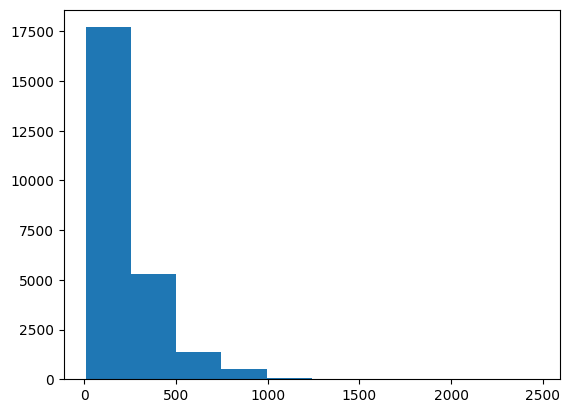

In [40]:
def pad_sequence(reviews_tokenized, sequence_length):
    ''' returns the tokenized review sequences padded with 0's or truncated to the sequence_length.
    '''
    padded_reviews = np.zeros((len(reviews_tokenized), sequence_length), dtype = int)

    for idx, review in enumerate(reviews_tokenized):
        review_len = len(review)

        if review_len <= sequence_length:
            zeroes = list(np.zeros(sequence_length-review_len))
            new_sequence = zeroes+review
        elif review_len > sequence_length:
            new_sequence = review[0:sequence_length]

        padded_reviews[idx,:] = np.array(new_sequence)

    return padded_reviews

sequence_length = 512
padded_reviews = pad_sequence(reviews_tokenized=reviews_tokenized, sequence_length=sequence_length)

plt.hist(reviews_len);

In [41]:
train_val_split = 0.75
train_X = padded_reviews[:int(train_val_split*len(padded_reviews))]
train_y = encoded_label_list[:int(train_val_split*len(padded_reviews))]
validation_X = padded_reviews[int(train_val_split*len(padded_reviews)):]
validation_y = encoded_label_list[int(train_val_split*len(padded_reviews)):]

Generating the training and testing dataset

In [42]:
train_dataset=TensorDataset(torch.from_numpy(train_X).to(device),torch.from_numpy(train_y).to(device))
validation_dataset=TensorDataset(torch.from_numpy(validation_X).to(device),torch.from_numpy(validation_y).to(device))

In [43]:
train_dataset

In [44]:
batch_size=32
# torch dataloaders (shuffle data)
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
validation_dataloader = DataLoader(validation_dataset, batch_size=batch_size, shuffle=True)

In [45]:
# get a batch of train data
train_data_iter = iter(train_dataloader)
X_example, y_example = next(train_data_iter)
print('Example Input size: ', X_example.size()) # batch_size, seq_length
print('Example Input:\n', X_example)
print()
print('Example Output size: ', y_example.size()) # batch_size
print('Example Output:\n', y_example)

Example Input size:  torch.Size([32, 512])
Example Input:
 tensor([[   0,    0,    0,  ...,  138,   27,  490],
        [   0,    0,    0,  ...,   42,    1, 2005],
        [   0,    0,    0,  ...,   37,   72,  124],
        ...,
        [   0,    0,    0,  ...,   15,   31,  560],
        [   0,    0,    0,  ...,  123,  390,   49],
        [   0,    0,    0,  ...,  252,  894, 6082]], device='cuda:0')

Example Output size:  torch.Size([32])
Example Output:
 tensor([1., 1., 0., 1., 1., 1., 0., 1., 0., 1., 1., 0., 0., 1., 1., 1., 1., 1.,
        0., 0., 0., 1., 0., 1., 1., 1., 1., 1., 1., 1., 1., 0.],
       device='cuda:0')


## RNN MODULE

In [46]:
class RNNModule(nn.Module):
    def __init__(self, input_dimension, embedding_dimension, hidden_dimension, output_dimension):
        super().__init__()
        self.embedding_layer = nn.Embedding(input_dimension, embedding_dimension)
        self.rnn_layer = nn.RNN(embedding_dimension, hidden_dimension, num_layers=1)
        self.fc_layer = nn.Linear(hidden_dimension, output_dimension)

    def forward(self, sequence):
        # sequence shape = (sequence_length, batch_size)
        embedding = self.embedding_layer(sequence)
        # embedding shape = [sequence_length, batch_size, embedding_dimension]
        output, hidden_state = self.rnn_layer(embedding)
        # output shape = [sequence_length, batch_size, hidden_dimension]
        # hidden_state shape = [1, batch_size, hidden_dimension]
        final_output = self.fc_layer(hidden_state[-1,:,:].squeeze(0))
        return final_output

input_dimension = len(vocab_to_token)+1 # +1 to account for padding
embedding_dimension = 100
hidden_dimension = 32
output_dimension = 1

rnn_model = RNNModule(input_dimension, embedding_dimension, hidden_dimension, output_dimension)

optim = torch.optim.Adam(rnn_model.parameters())
loss_func = nn.BCEWithLogitsLoss()

rnn_model = rnn_model.to(device)
loss_func = loss_func.to(device)

In [47]:
def accuracy_metric(predictions, ground_truth):
    """
    Returns 0-1 accuracy for the given set of predictions and ground truth
    """
    # round predictions to either 0 or 1
    rounded_predictions = torch.round(torch.sigmoid(predictions))
    success = (rounded_predictions == ground_truth).float() #convert into float for division
    accuracy = success.sum() / len(success)
    return accuracy

In [48]:
next(iter(train_dataloader))[0]

tensor([[    0,     0,     0,  ...,   402,    15,   496],
        [    0,     0,     0,  ...,     5,     1, 81140],
        [    0,     0,     0,  ...,    21,    49,   351],
        ...,
        [    0,     0,     0,  ...,     4,     1,  8367],
        [    0,     0,     0,  ...,  1471,   574, 14128],
        [    0,     0,     0,  ...,   127,  2428,    23]], device='cuda:0')

In [49]:
c=0
for sequence, sentiment in train_dataloader:
  print(sequence,sentiment)
  c+=1
  if c>6:
    break

tensor([[    0,     0,     0,  ...,    21,     1,  1573],
        [    0,     0,     0,  ...,   307,    12,    12],
        [    0,     0,     0,  ...,    33, 14201,    96],
        ...,
        [    0,     0,     0,  ..., 17451,  7548, 59254],
        [    0,     0,     0,  ...,     4,    29,   237],
        [    0,     0,     0,  ...,  3750, 61542, 24691]], device='cuda:0') tensor([1., 1., 1., 1., 0., 0., 1., 1., 1., 1., 0., 1., 0., 1., 0., 0., 1., 1.,
        1., 0., 0., 0., 1., 1., 0., 0., 1., 1., 1., 1., 1., 1.],
       device='cuda:0')
tensor([[    0,     0,     0,  ...,   311,   119,   430],
        [    0,     0,     0,  ...,   232,     4,     8],
        [    0,     0,     0,  ...,    25,    74,  2025],
        ...,
        [    0,     0,     0,  ...,   145,  1530, 15545],
        [    0,     0,     0,  ...,    29,   197,   305],
        [    0,     0,     0,  ...,  1394,   287,   577]], device='cuda:0') tensor([1., 0., 1., 1., 0., 1., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1

In [50]:
def train(model, dataLoader, optim, loss_func):
  loss=0
  accuracy=0
  model.train()
  for sequence, sentiment in dataLoader:
    optim.zero_grad()
    preds=model(sequence.T).squeeze()
    loss_curr=loss_func(preds, sentiment)
    loss_curr.backward()
    optim.step()
    loss+=loss_curr.item()
    accuracy+=accuracy_metric(preds, sentiment)
  return loss/len(dataLoader), accuracy/len(dataLoader)

In [51]:
def validate(model, dataloader, loss_func):
    loss = 0
    accuracy = 0
    model.eval()

    with torch.no_grad():
        for sequence, sentiment in dataloader:

            preds = model(sequence.T).squeeze()

            loss_curr = loss_func(preds, sentiment)
            accuracy_curr = accuracy_metric(preds, sentiment)

            loss += loss_curr.item()
            accuracy += accuracy_curr.item()

    return loss/len(dataloader), accuracy/len(dataloader)

In [52]:
import time

In [53]:
num_epochs = 10
best_validation_loss = float('inf')

for ep in range(num_epochs):

    time_start = time.time()

    training_loss, train_accuracy =  train(rnn_model, train_dataloader, optim, loss_func)
    validation_loss, validation_accuracy = validate(rnn_model, validation_dataloader, loss_func)

    time_end = time.time()
    time_delta = time_end - time_start

    if validation_loss < best_validation_loss:
        best_validation_loss = validation_loss
        torch.save(rnn_model.state_dict(), 'rnn_model.pt')

    print(f'epoch number: {ep+1} | time elapsed: {time_delta}s')
    print(f'training loss: {training_loss:.3f} | training accuracy: {train_accuracy*100:.2f}%')
    print(f'validation loss: {validation_loss:.3f} |  validation accuracy: {validation_accuracy*100:.2f}%')
    print()

epoch number: 1 | time elapsed: 4.728315353393555s
training loss: 0.616 | training accuracy: 67.08%
validation loss: 0.810 |  validation accuracy: 47.16%

epoch number: 2 | time elapsed: 3.9415745735168457s
training loss: 0.512 | training accuracy: 75.47%
validation loss: 0.720 |  validation accuracy: 63.59%

epoch number: 3 | time elapsed: 4.140101432800293s
training loss: 0.446 | training accuracy: 79.99%
validation loss: 0.790 |  validation accuracy: 53.29%

epoch number: 4 | time elapsed: 3.907001256942749s
training loss: 0.392 | training accuracy: 82.82%
validation loss: 0.915 |  validation accuracy: 56.58%

epoch number: 5 | time elapsed: 3.9156839847564697s
training loss: 0.326 | training accuracy: 86.73%
validation loss: 0.794 |  validation accuracy: 67.76%

epoch number: 6 | time elapsed: 4.643157482147217s
training loss: 0.252 | training accuracy: 90.39%
validation loss: 0.802 |  validation accuracy: 67.54%

epoch number: 7 | time elapsed: 3.9377028942108154s
training loss: 0

In [54]:
def sentiment_inference(model, sentence):
    model.eval()

    # text transformations
    sentence = sentence.lower()
    sentence = ''.join([c for c in sentence if c not in punctuation])
    tokenized = [vocab_to_token.get(token, 0) for token in sentence.split()]
    tokenized = np.pad(tokenized, (512-len(tokenized), 0), 'constant')

    # model inference
    model_input = torch.LongTensor(tokenized).to(device)
    model_input = model_input.unsqueeze(1)
    pred = torch.sigmoid(model(model_input))

    return pred.item()

In [56]:
import math

In [64]:

print(sentiment_inference(rnn_model, "in bastard didn't made sense but it was "))
print(sentiment_inference(rnn_model, "die hard died in end"))
print(sentiment_inference(rnn_model, "Director tried too hard but this film is bad"))
print(sentiment_inference(rnn_model, "bad boys were good"))
print(sentiment_inference(rnn_model, "This film is horrible"))

0.07164812088012695
0.9620335102081299
0.08854132890701294
0.5131908059120178
0.015909302979707718
